In [1]:
import pandas as pd
import numpy as np
import os
import sys
import scanpy as sc
import anndata as ad
import scipy
import time
import gget
from sklearn.decomposition import PCA

import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
from mpl_toolkits.axes_grid1.axes_divider import make_axes_locatable
import matplotlib.patheffects as pe

"""WARNING: disabling future warnings"""
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3' # and to omit tensorflow logging

""" Increase scanpy output"""
sc.settings.verbosity = 3

# local 
import utils as ut

In [2]:
fullpath = "/nfs/turbo/umms-indikar/shared/projects/MC3R/processed_data/all_clustered.h5ad"
raw = sc.read(fullpath)

# filter out non-neurons
adata = raw[raw.obs['cell_type'] == 'Neurons']
pdf = adata.copy()
pdf

AnnData object with n_obs × n_vars = 33647 × 25060
    obs: 'batch', 'reference_embedding_C7_named', 'reference_embedding_C25_named', 'C25_named', 'C7_named', 'reference_embedding_C7_named_clean', 'reference_embedding_C25_named_clean', 'C25_named_clean', 'C7_named_clean', 'UMAP1', 'UMAP2', 'Diet', 'Sex', 'broad_type', 'n_genes', 'color', 'leiden', 'cluster_num', 'Cluster', 'cluster_cat', 'U1', 'U2', 'cell_type'
    var: 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'Cluster', 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

## New embedding, same clusters

computing neighbors
    using 'X_pca' with n_pcs = 37


RuntimeError: module compiled against API version 0xf but this version of numpy is 0xe

    finished: added to `.uns['neuron_subcluster_neighbors']`
    `.obsp['neuron_subcluster_neighbors_distances']`, distances for each pair of neighbors
    `.obsp['neuron_subcluster_neighbors_connectivities']`, weighted adjacency matrix (0:01:01)
running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)
--> added 'pos', the PAGA positions (adata.uns['paga'])
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:41)


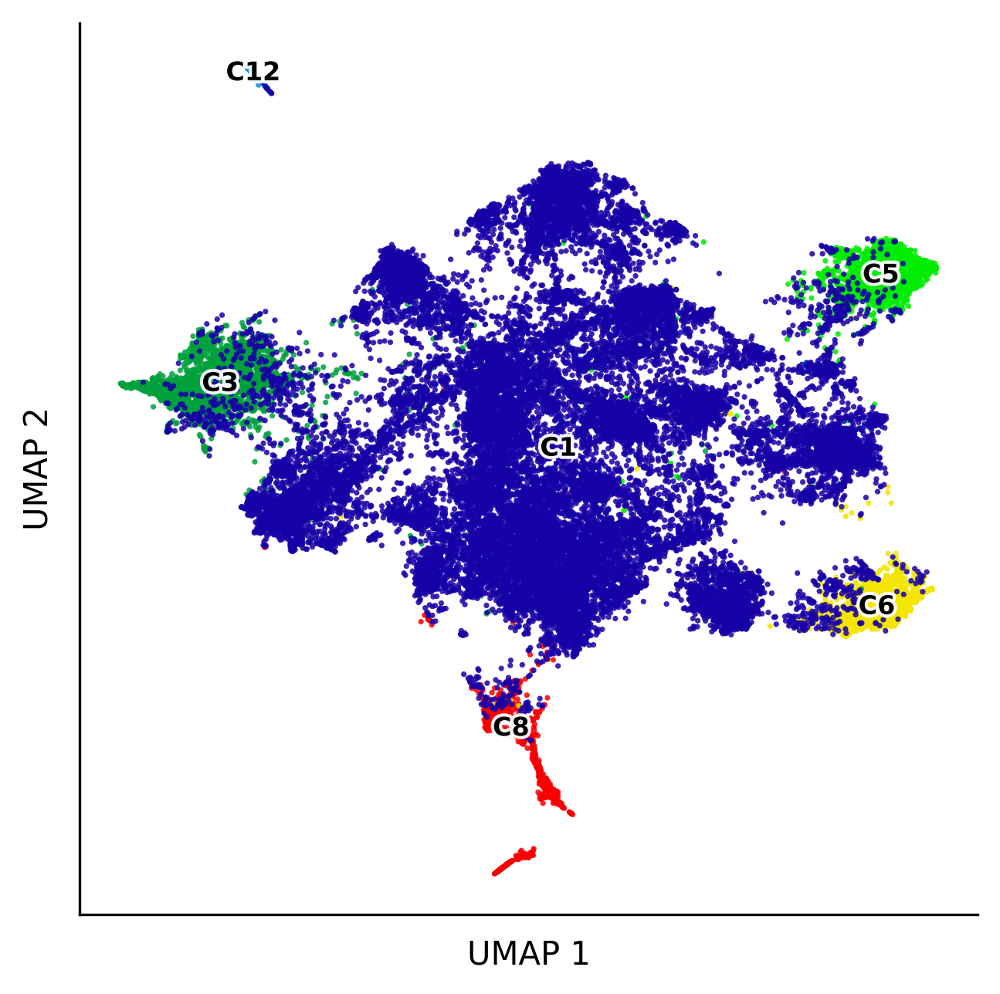

In [3]:
n_pca = 37
n_neighbors = 7
min_distance = 0.1
spread = 2.0
color_map = "nipy_spectral"
neighbors_key = 'neuron_subcluster_neighbors'

# establish the nieghborhood
sc.pp.neighbors(pdf, 
                n_neighbors=n_neighbors, 
                n_pcs=n_pca,
                key_added=neighbors_key)

# build coarse-grained connectivity structures of complex manifolds 
sc.tl.paga(pdf, groups='Cluster', neighbors_key=neighbors_key)
sc.pl.paga(pdf, plot=False)

# new embedding from the corse grained structures
sc.tl.umap(pdf, 
           init_pos='paga',
           neighbors_key=neighbors_key,
           min_dist=min_distance, 
           spread=spread)

# build new obs columns
pdf.obs['NU1'] = pdf.obsm['X_umap'][:, 0]
pdf.obs['NU2'] = pdf.obsm['X_umap'][:, 1]

""" UMAP PLOT """
plt.rcParams['figure.dpi'] = 300
plt.rcParams['figure.figsize'] = 5, 5

# sort the data frame
pdx = pdf.obs.copy()
pdx = pdx.sort_values(by='cell_type')
pdx = pdx.reset_index()

hue_order = sorted(pdx['Cluster'].unique())
order = np.argsort(pdx['Cluster'])[::-1]

sns.scatterplot(data=pdx.iloc[order],
                x='NU1',
                y='NU2',
                hue='Cluster',
                hue_order=hue_order,
                palette='nipy_spectral',
                s=3,
                alpha=0.85,
                ec='none'
        )

sns.despine()
plt.xticks([])
plt.yticks([])

plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")

# label on data
ax = plt.gca()

all_pos = (
        pdx.groupby('Cluster')[['NU1', 'NU2']]
        .median()
        .sort_index()
    )

for label, x_pos, y_pos in all_pos.itertuples():
    ax.text(
        x_pos,
        y_pos,
        label,
        weight='bold',
        path_effects=[pe.withStroke(linewidth=2, foreground="w", alpha=0.95,)],
        verticalalignment="center",
        horizontalalignment="center",
        fontsize='8',
    )

plt.gca().legend().remove()



# Diagnostic Plots

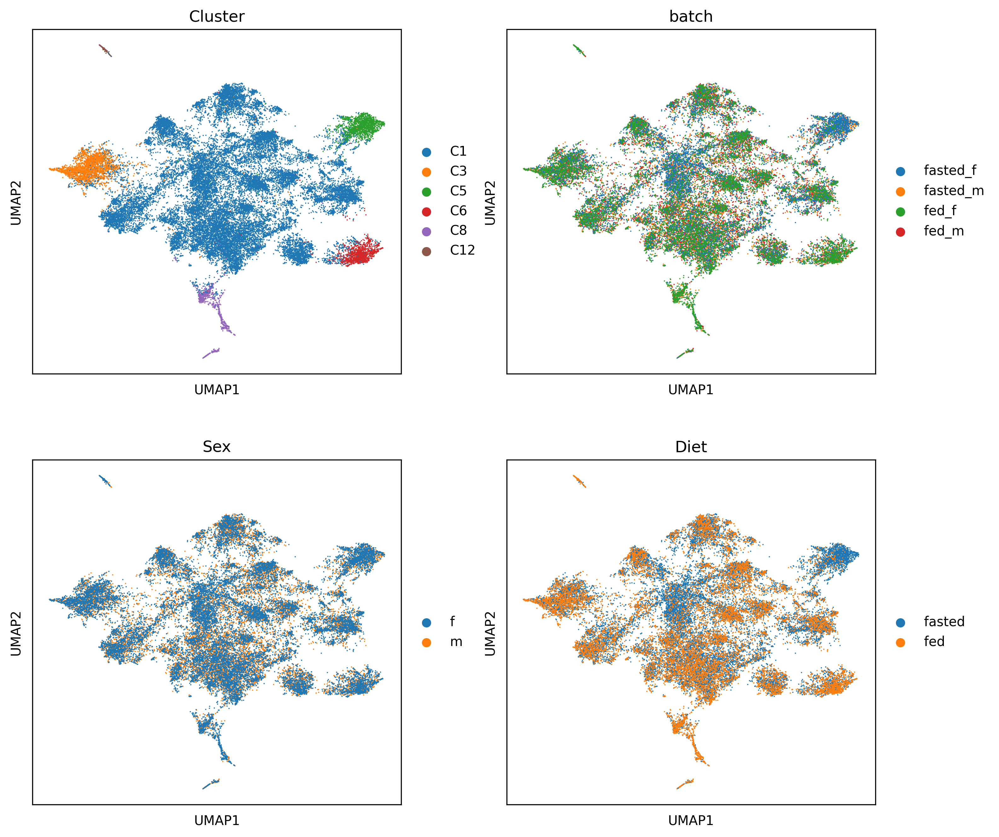

In [5]:
sc.pl.umap(pdf, color=['Cluster', 'batch', 'Sex', 'Diet'], ncols=2)

... storing 'HypoMap' as categorical


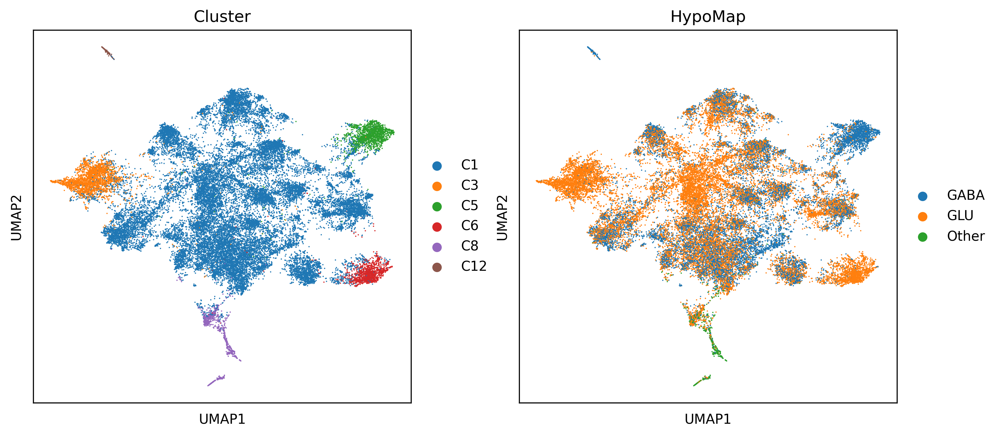

In [6]:
pdf.obs['HypoMap'] = pdf.obs['reference_embedding_C7_named_clean'].astype('string').str.strip()
pdf.obs['HypoMap'] = np.where(~pdf.obs['HypoMap'].isin(['GABA', 'GLU']), 'Other', pdf.obs['HypoMap'])

sc.pl.umap(pdf, color=['Cluster', 'HypoMap'])

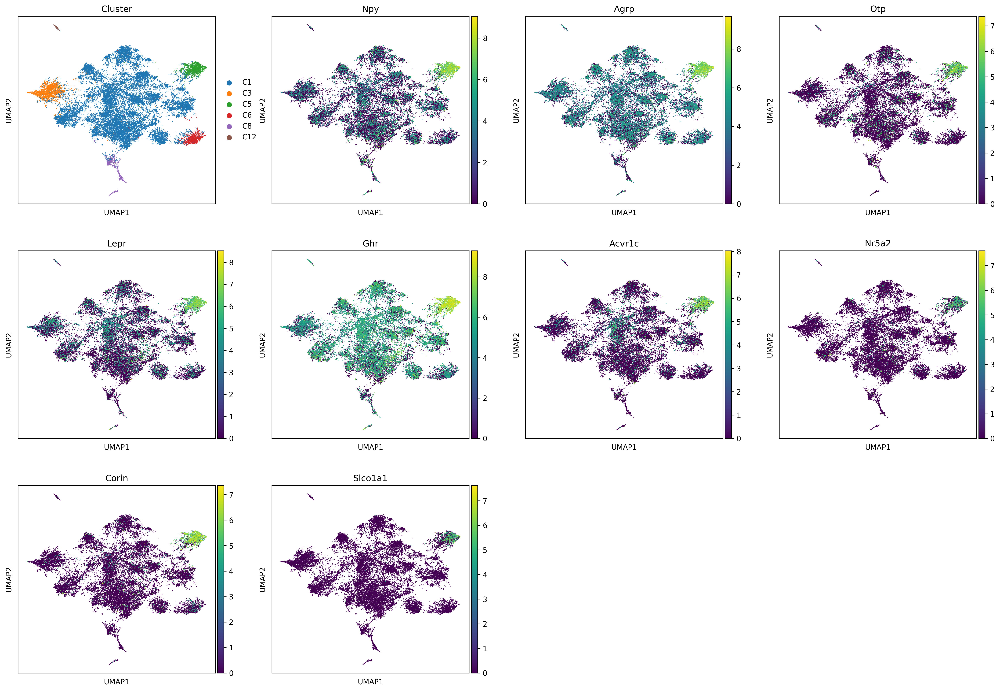

In [7]:
gene_list = [
    'Npy',
    'Agrp',
    'Otp',
    'Lepr',
    'Ghr',
    'Acvr1c',
    'Nr5a2',
    'Corin',
    'Slco1a1'
]

sc.pl.umap(pdf, color=['Cluster'] + gene_list, ncols=4)

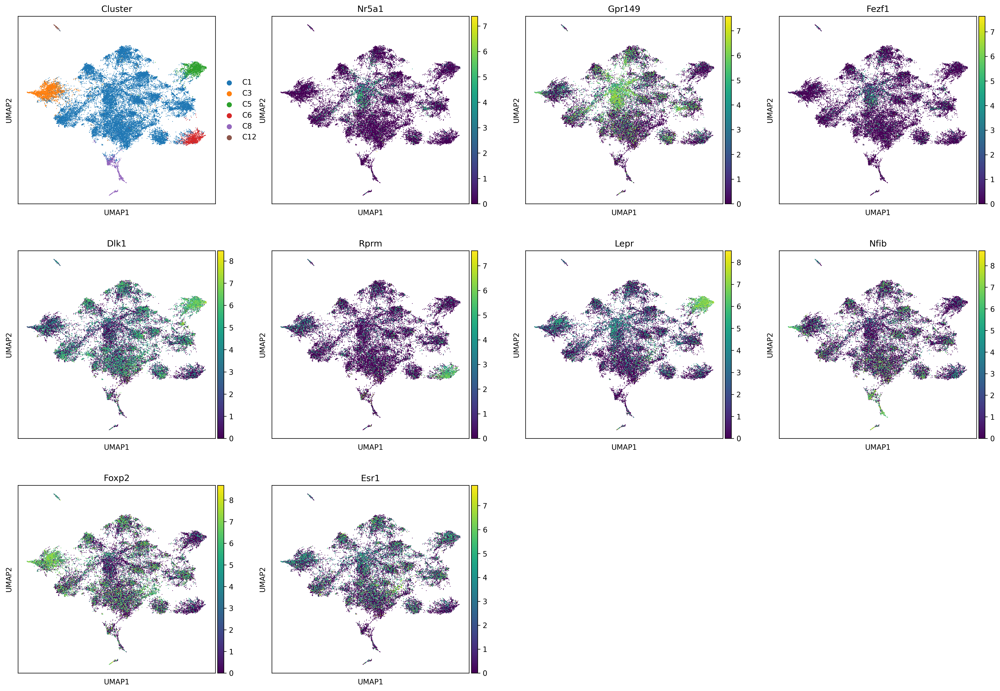

In [8]:
gene_list = [
    'Nr5a1', 
    'Gpr149', 
    'Fezf1',
    'Dlk1', 
    'Rprm',
    'Lepr',
    'Nfib', 
    'Foxp2',
    'Esr1'
]

sc.pl.umap(pdf, color=['Cluster'] + gene_list, ncols=4)

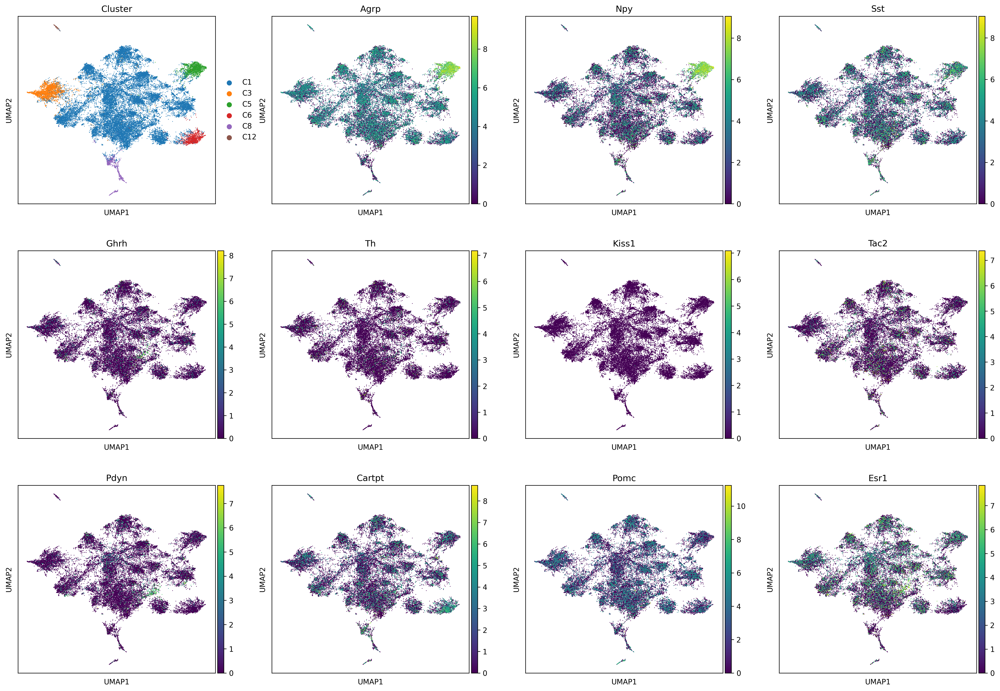

In [9]:
arcuate = ['Agrp','Npy','Sst','Ghrh','Th','Kiss1','Tac2','Pdyn','Cartpt','Pomc','Esr1',]
sc.pl.umap(pdf, color=['Cluster'] + arcuate, ncols=4)

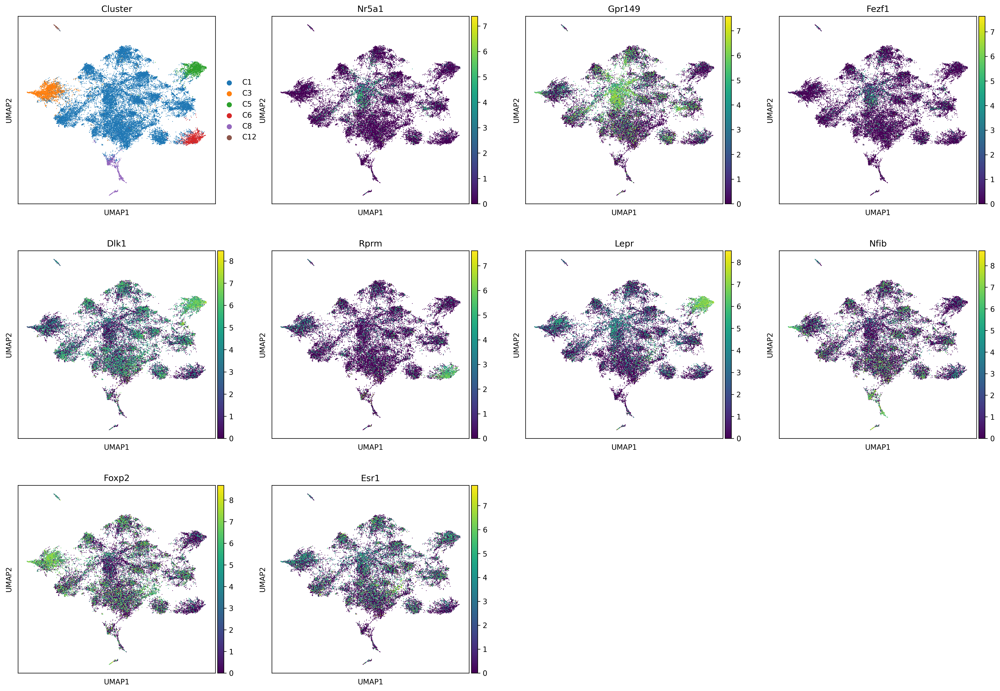

In [12]:
VMH = ['Nr5a1','Gpr149','Fezf1','Dlk1','Rprm','Lepr','Nfib','Foxp2','Esr1',]
sc.pl.umap(pdf, color=['Cluster'] + VMH, ncols=4)

In [13]:
# load neuropeptides
pep_path = "/nfs/turbo/umms-indikar/shared/projects/MC3R/neuropeptides/group-1902.csv"
ndf = pd.read_csv(pep_path, skiprows=1)

neuropeptides = ndf['Approved symbol'].unique()
print(f"{len(neuropeptides)=}")
ndf.head()






len(neuropeptides)=64


,HGNC ID (gene),Approved symbol,Approved name,Previous symbols,Aliases,Chromosome
0,HGNC:241,ADCYAP1,adenylate cyclase activating polypeptide 1,NaN,PACAP,18p11.32
1,HGNC:259,ADM,adrenomedullin,NaN,AM,11p15.4
2,HGNC:28898,ADM2,adrenomedullin 2,NaN,"AM2,FLJ21135",22q13.33
3,HGNC:330,AGRP,agouti related neuropeptide,NaN,"Agrt,ART,ASIP2",16q22.1
4,HGNC:333,AGT,angiotensinogen,SERPINA8,NaN,1q42.2
